In [1]:
import asyncio
from autogen_ext.models.openai import OpenAIChatCompletionClient
from dotenv import load_dotenv
import os

load_dotenv()
api_key= os.getenv("OPENAI_API_KEY")
model_client = OpenAIChatCompletionClient(model="gpt-4o", api_key=api_key)

python-dotenv could not parse statement starting at line 5
python-dotenv could not parse statement starting at line 6


In [2]:
from autogen_agentchat.agents import AssistantAgent

planner = AssistantAgent(
    name="Planner",
    model_client=model_client,
    description="Breaks a project into clear, manageable tasks",
    system_message="You are an expert project planner. Given a project description, break it into clear, actionable tasks with milestones."
)

resource_allocator = AssistantAgent(
    name="ResourceAllocator",
    model_client=model_client,
    description="Suggests tools and people for each task",
    system_message="You suggest the best tools, technologies, and people roles for the tasks provided. Keep it concise."
)

deadline_tracker = AssistantAgent(
    name="DeadlineTracker",
    model_client=model_client,
    description="Keeps timeline in check",
    system_message="You create realistic deadlines for each task, ensuring the project can finish on time."
)

quality_checker = AssistantAgent(
    name="QualityChecker",
    model_client=model_client,
    description="Ensures standards are met",
    system_message="You check the tasks, resources, and deadlines for quality and feasibility. If everything looks good, respond TERMINATE."
)


In [ ]:
from autogen_agentchat.teams import RoundRobinGroupChat
from autogen_agentchat.conditions import TextMentionTermination

termination_condition = TextMentionTermination(text="TERMINATE")

pm_team = RoundRobinGroupChat(
    participants=[planner, resource_allocator, deadline_tracker, quality_checker],
    termination_condition=termination_condition,
    max_turns=12
)


In [4]:
from autogen_agentchat.messages import TextMessage
import asyncio

async def run_pm_team():
    task = TextMessage(
        content="Plan a 3-month project to develop a mobile app for food delivery.",
        source="User"
    )

    result = await pm_team.run(task=task)

    for msg in result.messages:
        print(f"{msg.source}: {msg.content}")

await run_pm_team()


User: Plan a 3-month project to develop a mobile app for food delivery.
Planner: To develop a mobile app for food delivery over a 3-month period, we will break the project into several phases with clear, actionable tasks and milestones. The project will be divided into five key phases: Planning, Design, Development, Testing, and Launch. Here's a detailed plan:

### Phase 1: Planning (Week 1)

**Tasks:**
- **Conduct Market Research:**
  - Identify user needs and preferences.
  - Analyze competitors' apps.
  - Define unique selling propositions (USP).

- **Define Project Scope:**
  - Draft a detailed project requirements document.
  - Set the app features list (user registration, menu browsing, order placement, delivery tracking, payment gateways).

- **Formulate Project Plan:**
  - Establish a timeline.
  - Allocate resources, including a development team, designers, and testers.

### Milestone 1: Approval of Project Scope and Requirements

### Phase 2: Design (Weeks 2-3)

**Tasks:**
- 

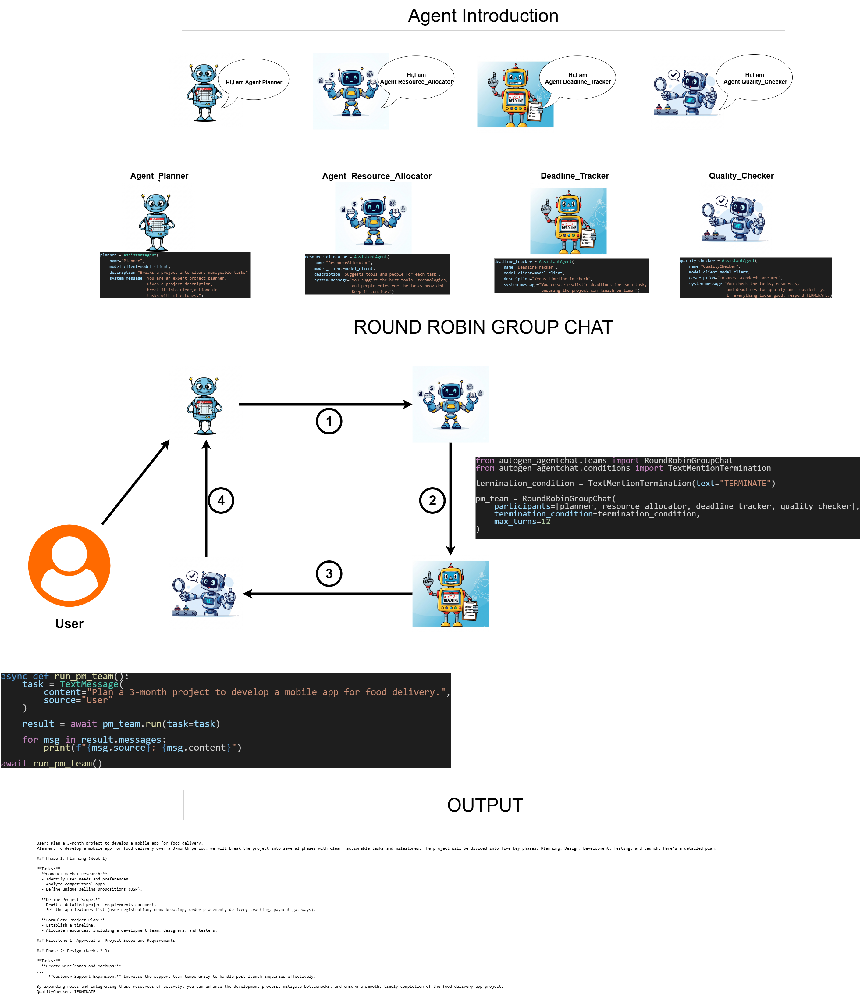